<a href="https://colab.research.google.com/github/sunnysinghnitb/google_colab_notes/blob/master/Analyzing_the_Impact_of_2007_2008_Financial_Crisis_on_6_Major_US_Banks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Introduction

In this Python Report, we will focus on exploratory data analysis of stock prices of the 6 major US banks and see how they progressed throughout the financial crisis all the way to 2016. For those who don't know, the 2008 financial crisis is the worst economic disaster since the Great Depression of 1929. It occurred despite Federal Reserve and Treasury Department efforts to prevent it. It led to the Great Recession. That's when housing prices fell 31.8 percent, more than the price plunge during the Depression. 

The 6 banks, we used, in this analysis are Bank of America, CitiGroup, Goldman Sachs, JPMorgan Chase, Morgan Stanley, and Wells Fargo. 

## Result of the analysis

* All bank stocks plummeted around the same time during the 2007-2008 financial crisis.
* The scale of the collapse for CitiGroup stock was significantly more pronounced than other banks in the crisis.
* All stocks have been seeing a gradual rising trend since mid-2012.
* The differences between the min. and max. stock prices are enormous in this period (4.4x - 124.8x).
* After 2008, Goldman Sachs's stock price is consistently and considerably higher than all other banks.

Let's start.

## Import libraries
First we need to start with the proper imports required for the analysis.

In [0]:
# Basic Python libraries
from pandas_datareader import data, wb
import pandas as pd
import numpy as np
import datetime

# Basic visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
%matplotlib inline

# Interactive visualization libraries
import plotly
import cufflinks as cf
cf.go_offline()

Let's define the time limit for the data to be used. Use datetime to set start and end datetime objects.

In [0]:
start = datetime.datetime(2006, 1, 1)
end = datetime.datetime(2016, 12, 31)

We'll use Pandas to directly read data from Yahoo Finance. You’ll need to install pandas-datareader for this to work. Pandas datareader allows you to read stock information directly from the internet. We will get stock information for the following banks:  

* Bank of America (BAC) 
* CitiGroup (C)
* Goldman Sachs (GS)
* JPMorgan Chase (JPM)
* Morgan Stanley (MS)
* Wells Fargo (WFC)

To get the stock data from Jan 1st 2006 to Dec 31st 2016 for each of these banks, set each bank to be a separate dataframe. 

In [0]:
BAC = data.DataReader("BAC", 'yahoo', start, end)
C = data.DataReader("C", 'yahoo', start, end)
GS = data.DataReader("GS", 'yahoo', start, end)
JPM = data.DataReader("JPM", 'yahoo', start, end)
MS = data.DataReader("MS", 'yahoo', start, end)
WFC = data.DataReader("WFC", 'yahoo', start, end)

In [48]:
df = data.DataReader(['BAC', 'C', 'GS', 'JPM', 'MS', 'WFC'],'yahoo', start, end)
tickers = ['BAC', 'C', 'GS', 'JPM', 'MS', 'WFC']
bank_stocks = pd.concat([BAC, C, GS, JPM, MS, WFC],axis=1,keys=tickers)
bank_stocks.columns.names = ['Bank Ticker','Stock Info']

bank_stocks.head()

Bank Ticker        BAC                        ...        WFC                       
Stock Info        High        Low       Open  ...      Close      Volume  Adj Close
Date                                          ...                                  
2006-01-03   47.180000  46.150002  46.919998  ...  31.900000  11016400.0  21.485973
2006-01-04   47.240002  46.450001  47.000000  ...  31.530001  10870000.0  21.236753
2006-01-05   46.830002  46.320000  46.580002  ...  31.495001  10158000.0  21.213186
2006-01-06   46.910000  46.349998  46.799999  ...  31.680000   8403800.0  21.337786
2006-01-09   46.970001  46.360001  46.720001  ...  31.674999   5619600.0  21.334421

[5 rows x 36 columns]

## Let's quickly visualize the daily Close Price for each of these banks 

Most part of this report will focus on visualizations. Feel free to use any of your preferred visualization libraries (seaborn, matplotlib, plotly and cufflinks, or just pandas) to recreate the described plots below.

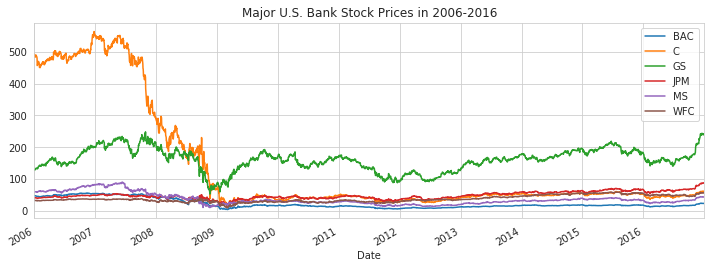

In [49]:
# Use .plot function to visualize the data in the bank_stocks dataframe (Bank Stock Prices)

for x in tickers:
    bank_stocks[x]['Close'].plot(label=x,figsize=(12,4),title="Major U.S. Bank Stock Prices in 2006-2016")
plt.legend()

## Let's analyze the above chart

All stocks plummeted between mid-2008 and early 2009.
* The CitiGroup is significantly more pronounced than other banks.
* After hitting the bottom in 2009, these stocks seem to have since recovered, with the exception of early 2012.
* There seem to be bigger price fluctuations every few years, on top of the daily and weekly fluctuations.
* Mid-2011 to mid-2012 seems to be a bad period for these banks as well.
* After mid-2012, all stocks are seeing a gradual rising trend.
* Excluding CitiGroup before 2008, Goldman Sachs's stock price is consistently higher than other banks.

However, the above observations deserve greater examination since the scale of the chart makes it very difficult to observe the trends of the lines at the bottom, which are relatively smaller in value. To solve this problem. let's try to use more interactive visualization libraries that allow us to zoom in and see the values of each data point.

## Interactive Visualization
Besides using pandas and matplotlib to create static charts like the one above, we can also use libraries such as Plotly to build interactive visualizations.

In the chart below, you can zoom, drag, and see the labels of each data point. 

### You need to add a method in order to use Plotly in Colab. This method must be executed for every cell which is displaying a Plotly graph.

In [0]:
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
    init_notebook_mode(connected=False)

In [67]:
# Add the method
enable_plotly_in_cell()

# Use Plotly library to build an interactive visualization of the stock prices
bank_stocks.xs(key='Close',axis=1,level='Stock Info').iplot(title='Major U.S. Bank Stock Prices in 2006-2016')

On the above chart, you can zoom into any periods to see the change in stock prices more clearly.
Now, we can confirm that the above observations are true.

Another commonly used financial visualization is the candle plot – which shows you all the Open, High, Low, and Close prices every day. Hover over the line to see the exact values.

In [68]:
enable_plotly_in_cell()

# Use candle plot to show the various daily stock prices for Morgan Stanley from 2006 to 2016
bac15 = bank_stocks['MS'][['Open','High','Low','Close']].loc['2006-01-01':'2016-12-31']
bac15.iplot(kind='candle',title='Morgan Stanley Stock Price in 2006-2016')

## Extracting some important points
Besides visualizing data, Python also offers a lot of functions to analyze data, compute commonly used statistics, and calculate additional values using our custom formula.

Here I'll show you a few useful functions.

Let's apply some functions and use Statistics to get a deeper insight of our graphs

In [52]:
# Identify the maximum close price for each bank stock from 2006 to 2016 using a for loop

for x in tickers:
    print(x,bank_stocks[x]['Close'].max())

BAC 54.900001525878906
C 564.0999755859375
GS 247.9199981689453
JPM 87.12999725341797
MS 89.30000305175781
WFC 58.52000045776367


In [53]:
# Identify the minimum close price for each bank stock from 2006 to 2016 using a for loop

for x in tickers:
    print(x,bank_stocks[x]['Close'].min())

BAC 3.140000104904175
C 10.199999809265137
GS 52.0
JPM 15.899999618530273
MS 9.199999809265137
WFC 8.119999885559082


You can see that the differences between the min. & max. stock prices are huge between 2006 and 2016. The highest stock price of CitiGroup is 124.8x of its lowest point. Even if we ignore the outlier (Citi), the difference for Bank of America is 17.5x as well.

## Analyzing the changes in stock price
It's unfair to compare the absolute differences between these stocks because they are priced at a significantly different range. Also, it's hard to observe the trends of those 4 banks with lower stock prices in the chart since they are squeezed into a small scale.

Therefore, I'm going to use .pct_change function to create a new dataframe to show the daily % change in stock close prices to better understand their relative changes.

In [54]:
# Create an empty dataframe called Returns
returns = pd.DataFrame()

# Use pandas pct_change() method, i.e. percentage change method, to calculate the daily stock return
# Create a table showing the DoD % change in Close stock price

for y in tickers:
    returns[y+' Return'] = bank_stocks[y]['Close'].pct_change()
    
# Make sure we got the right data
# Note that the first row is NaN because the first day doesn't have any percentage change

returns.head()    

,BAC Return,C Return,GS Return,JPM Return,MS Return,WFC Return
Date,,,,,,
2006-01-03,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-04,-0.010620,-0.018462,-0.013812,-0.014183,0.000686,-0.011599
2006-01-05,0.001288,0.004961,-0.000393,0.003029,0.002742,-0.001110
2006-01-06,-0.001501,0.000000,0.014169,0.007046,0.001025,0.005874
2006-01-09,0.000644,-0.004731,0.012030,0.016242,0.010586,-0.000158


## Quick visualization for trend spotting (Pairplot)
Let me use the pairplot function of Seaborn (visualization library) to quickly plot the Daily Return of all banks against each other.

This will give us 36 charts because we have 6 banks (6x6=36). The pairplot function is the quickest way to visualize data to spot simple trends.

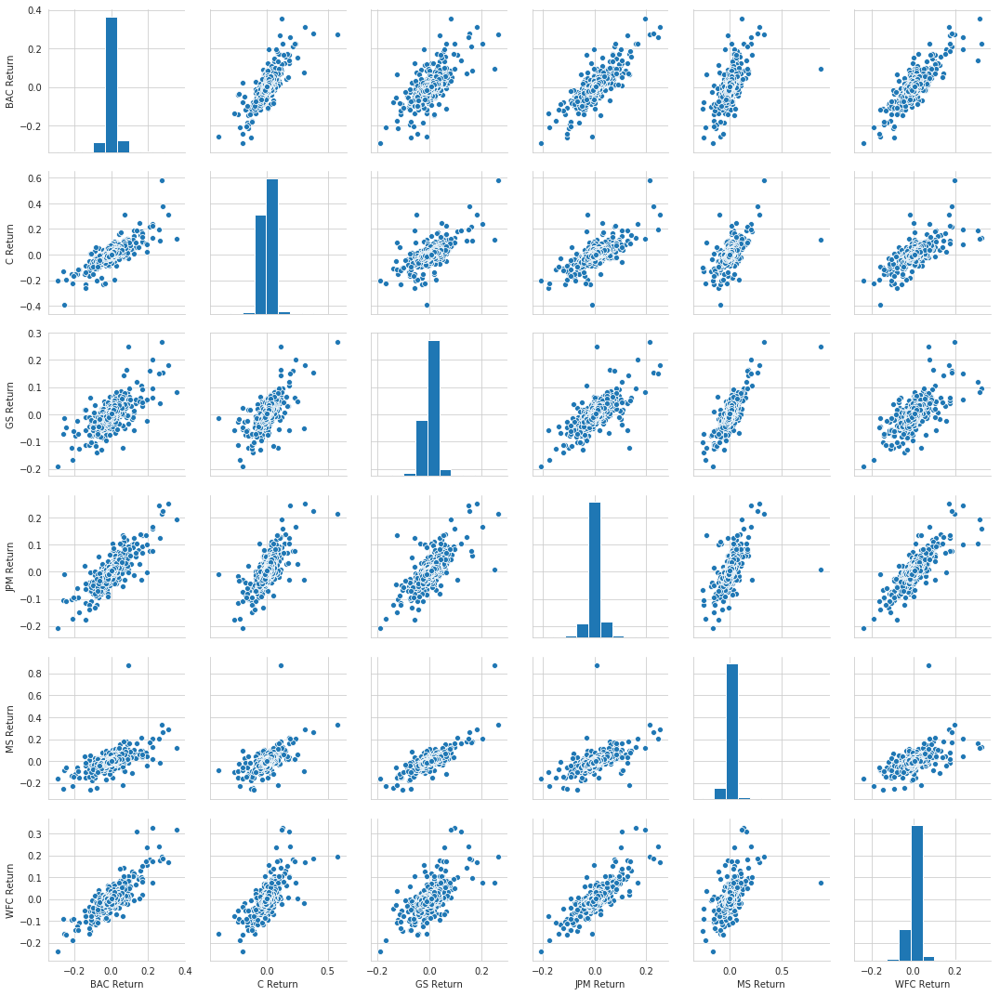

In [55]:
sns.pairplot(returns.loc['2006-01-04':'2016-12-31'])

### Daily returns of most bank stocks follow the market trend. CitiGroup seems to be the outlier.
From the charts above, you can see that the daily returns of most banks tend to move in tandem – when the stock of one bank goes up on that particular day (i.e. higher return), the other stock also goes up. That's why we can see a positive slope in most charts. This makes sense because stock prices of companies generally follow the "market trend" – when the market goes up, the stock prices of most companies go up.

The exception to the above trend is CitiGroup. All dots for Citi tend to stick to 0. Let's dig deeper to understand more.

## Let's dig deeper into the data
Find the dates when the returns are the lowest for each bank (i.e. most negative)

In [56]:
#The .idxmin() function shows the index of the minimum value

returns.idxmin()

BAC Return   2009-01-20
C Return     2009-02-27
GS Return    2009-01-20
JPM Return   2009-01-20
MS Return    2008-10-09
WFC Return   2009-01-20
dtype: datetime64[ns]

You can see that 4 out of 6 banks have the most negative return on the same date (20 Jan, 2009). Guess what? That's the date when major Wall Street stocks plummeted during the 2008 financial crisis, which lasted for a couple of years. Even Morgan Stannley's biggest drop happened around the same time, in October 2008.

This makes sense. As we know from the above, individual stock performance tends to follow the market trend. They should go up and down at similar times.

However, CitiGroup seems to be the exception again – the poorest return happens in 2011, a few years after the major financial crisis between 2007-2009.

For outliers like this, it's better to understand if there are other external influences at play. With a quick Google search, we can see that CitiGroup implemented a Reverse Stock Split on May 6, 2011, which made its stock price go down temporarily. This may explain the reason for its abnormality. For more information, please refer to this announcement.

Let's see how the stock price actually looks like for CitiGroup in that period.

## CitiGroup Stock Price 2011 H1

In [69]:
enable_plotly_in_cell()

# Use .iplot() to show an interactive chart of CitiGroup's stock price
bank_stocks['C']['Close'].loc['2011-01-01':'2011-06-30'].iplot()

As you can see, what we found is correct. There was a temporary dip in the Close Price on May 6, 2011. It quickly bounced back on May 9, when the market opened again. Note that May 6 was a Friday and May 9 was a Monday. The market closed at the weekend so there was no data in between.

The temporary dip on May 9 has no major impact on the moving average (see chart below).

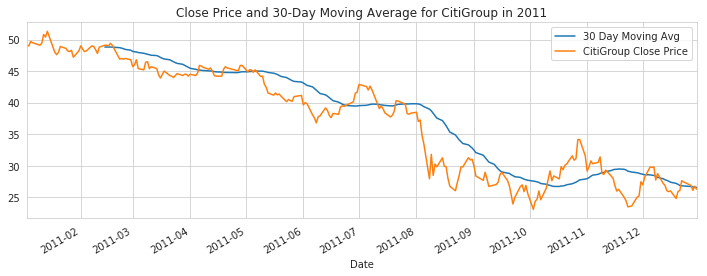

In [60]:
# Show the 30-day moving average of CitiGroup's stock price using the .rolling function

plt.figure(figsize=(12,4))
bank_stocks['C']['Close'].loc['2011-01-01':'2011-12-31'].rolling(window=30).mean().plot(label='30 Day Moving Avg',title='Close Price and 30-Day Moving Average for CitiGroup in 2011')
bank_stocks['C']['Close'].loc['2011-01-01':'2011-12-31'].plot(label='CitiGroup Close Price')
plt.legend()

### Then the question becomes: if we remove the abnormal day of May 6, 2011, will the same trends found in other banks apply to CitiGroup?

In [61]:
# Let's see when the biggest drop happened before May 6, 2011
returns.loc['2006-01-01':'2011-05-05'].idxmin()

BAC Return   2009-01-20
C Return     2009-02-27
GS Return    2009-01-20
JPM Return   2009-01-20
MS Return    2008-10-09
WFC Return   2009-01-20
dtype: datetime64[ns]

Now it all makes sense: the biggest drop for Citi before May 6, 2011 happened around the same time as the other banks during the financial crisis from 2007 to 2009.

### The abnormality in CitiGroup's data seems to be caused by an external event on May 6, 2011. Everything else looks normal if we remove this outlier.

The external event is likely to be Citi's Reverse Stock Split on May 6, 2011 (Friday). If we redraw our previous pairplot without this date, the results will look normal for CitiGroup as well (positive slope for all charts, except the ones against its own return).

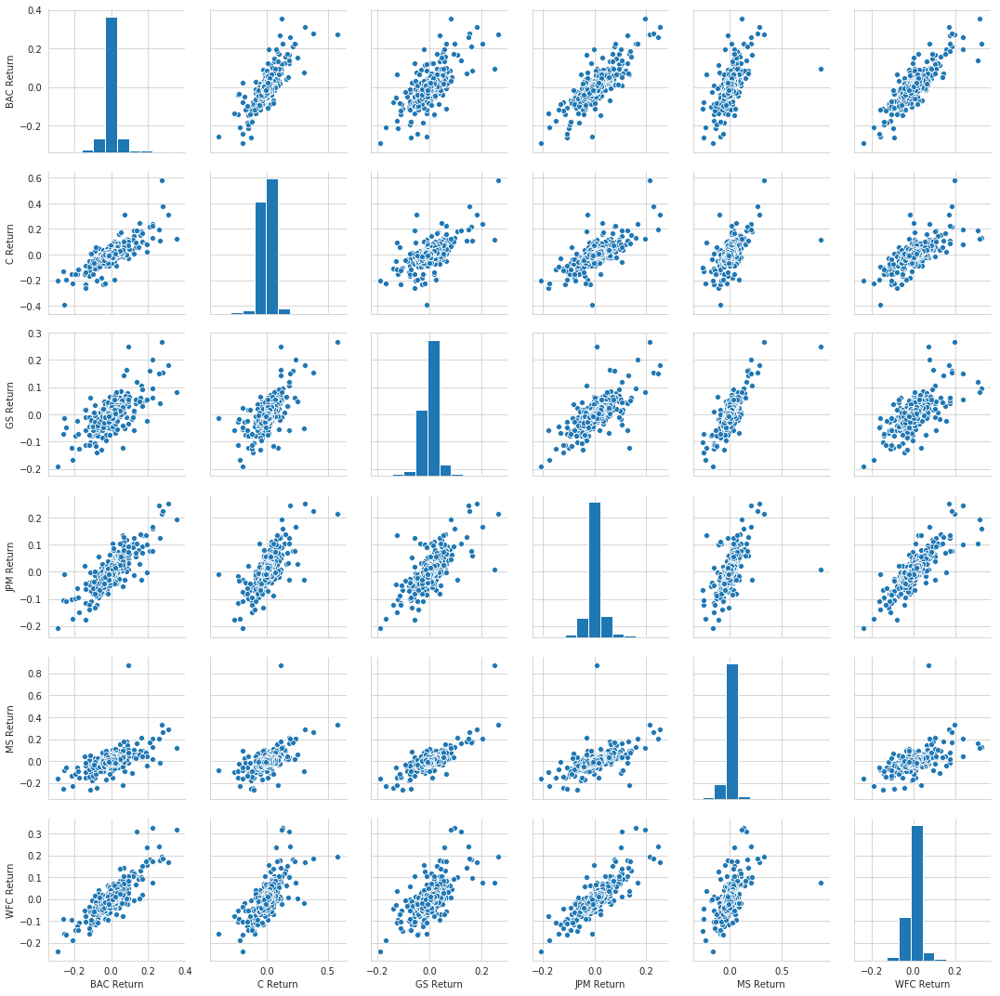

In [62]:
# Pairplot between 4 Jan, 2006 - 5 May, 2011 looks normal (positive slopes for all charts)
sns.pairplot(returns.loc['2006-01-04':'2011-05-05'])

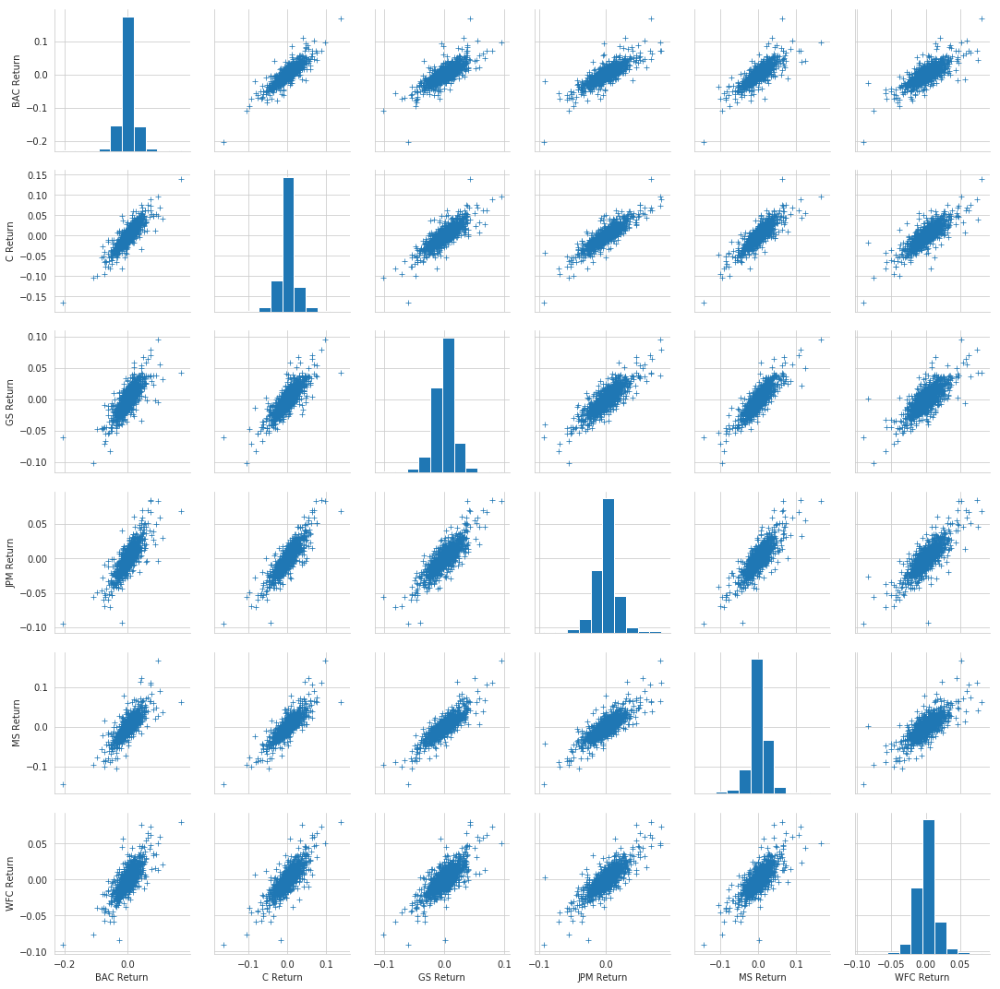

In [63]:
# Pairplot between 10 May, 2011 - 31 Dec, 2016 looks normal (positive slopes for all charts)
sns.pairplot(returns.loc['2011-05-10':'2016-12-31'],markers="+")

Great! We've identified with the problem with Citi. Let's see what else Python can do to analyze this dataset.

## Calculating the Risk

Standard deviation is one of the many indicators for the risk of each stock – the higher the standard deviation for the stock's daily return (% change) is, the wider the returns are distributed in that period, which also means the returns fluctuate a lot. As the stock is more volatile, it's also more risky.

In [64]:
# Use the .std function to calculate the standard deviation of the returns for the entire period (2006-2016)

returns.std()

BAC Return    0.035467
C Return      0.037360
GS Return     0.024736
JPM Return    0.026794
MS Return     0.036583
WFC Return    0.029184
dtype: float64

CitiGroup has the highest standard deviation, meaning it's the most volatile. This makes sense since we've seen its stock price fall drastically over the years.

Of course, the risk changes over time. For example, it's different in 2015, when Bank of America and Morgan Stanley seem to be more volatile. That said, the fluctuation seems to be similar across banks.

In [65]:
returns.loc['2015-01-01':'2015-12-31'].std()

BAC Return    0.016163
C Return      0.015289
GS Return     0.014046
JPM Return    0.014017
MS Return     0.016249
WFC Return    0.012591
dtype: float64

## Summary: Python features used in this project

Hope you've enjoyed this Python project and learned how Python can be used for data analysis and visualization. Let's have a quick recap of the various Python features and techniques used in this report:

* Import powerful data analysis and visualization libraries (numpy, pandas, matplotlib, plotly & cufflinks)
* Import external data set for analysis
* Compute commonly used statistics under custom conditions (minimum, maximum, standard deviation, moving average & percentage change)
* Create a new table (dataframe) with newly calculated values using built-in computing functions
* Build static and interactive visualizations

Feel free to contact me at sunny@doeity.com if you have any queries regarding this notebook.